In [1]:
# Load packages and data:
import xarray as xr
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from mpl_toolkits.basemap import Basemap
from mpl_toolkits.basemap import shiftgrid
from matplotlib.gridspec import GridSpec
from cartopy.crs import EqualEarth, PlateCarree

from xeofs.models import EOF, EOFRotator, ExtendedEOF

import geopandas as gpd
from shapely.geometry import Point

In [2]:
fp = '../data/sst.mnmean.nc'
sst = xr.open_dataset(fp)

In [3]:
# my_sst = sst['sst'][1500:]
my_sst = sst['sst']
my_sst = my_sst.groupby("time.month") - my_sst.groupby("time.month").mean("time")

In [4]:
eeof = ExtendedEOF(n_modes=15, tau=1, embedding=120, n_pca_modes=50)
eeof.fit(my_sst, dim="time")
components_ext = eeof.components()
scores_ext = eeof.scores()

sst_trends = eeof.inverse_transform(scores_ext.sel(mode=1))
sst_detrended = my_sst - sst_trends

In [5]:
eof_model_detrended = EOF(n_modes=15, standardize=False, use_coslat=True)
eof_model_detrended.fit(sst_detrended, dim="time")

rotator = EOFRotator(n_modes=15)
rotator.fit(eof_model_detrended)
expvar = rotator.explained_variance()
expvar_ratio = rotator.explained_variance_ratio()
rcomponents = rotator.components()
rscores = rotator.scores()

In [6]:
print("Explained variance: ", expvar.round(0).values)
print("Relative: ", (expvar_ratio * 100).round(1).values)

Explained variance:  [200. 145. 113. 107.  77.  73.  72.  69.  69.  67.  64.  64.  60.  60.
  58.]
Relative:  [7.1 5.1 4.  3.8 2.7 2.6 2.5 2.4 2.4 2.4 2.3 2.2 2.1 2.1 2. ]


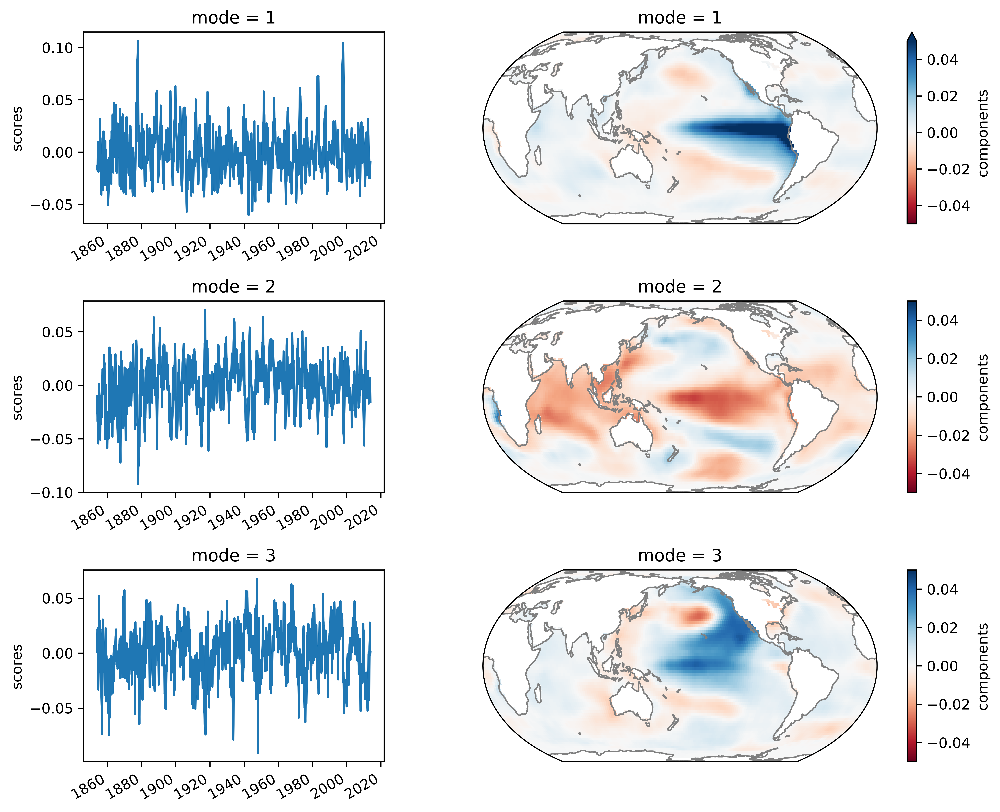

In [7]:
initial_mode=1

proj = EqualEarth(central_longitude=180)
kwargs = {"cmap": "RdBu", "vmin": -0.05, "vmax": 0.05, "transform": PlateCarree()}

fig = plt.figure(figsize=(10, 8), dpi=700)
gs = GridSpec(3, 2, width_ratios=[1, 2])
ax0 = [fig.add_subplot(gs[i, 0]) for i in range(3)]
ax1 = [fig.add_subplot(gs[i, 1], projection=proj) for i in range(3)]

for i, (a0, a1) in enumerate(zip(ax0, ax1)):
    rscores.sel(mode=i + initial_mode).plot(ax=a0)
    a1.coastlines(color=".5")
    rcomponents.sel(mode=i + initial_mode).plot(ax=a1, **kwargs)

    a0.set_xlabel("")

plt.tight_layout()

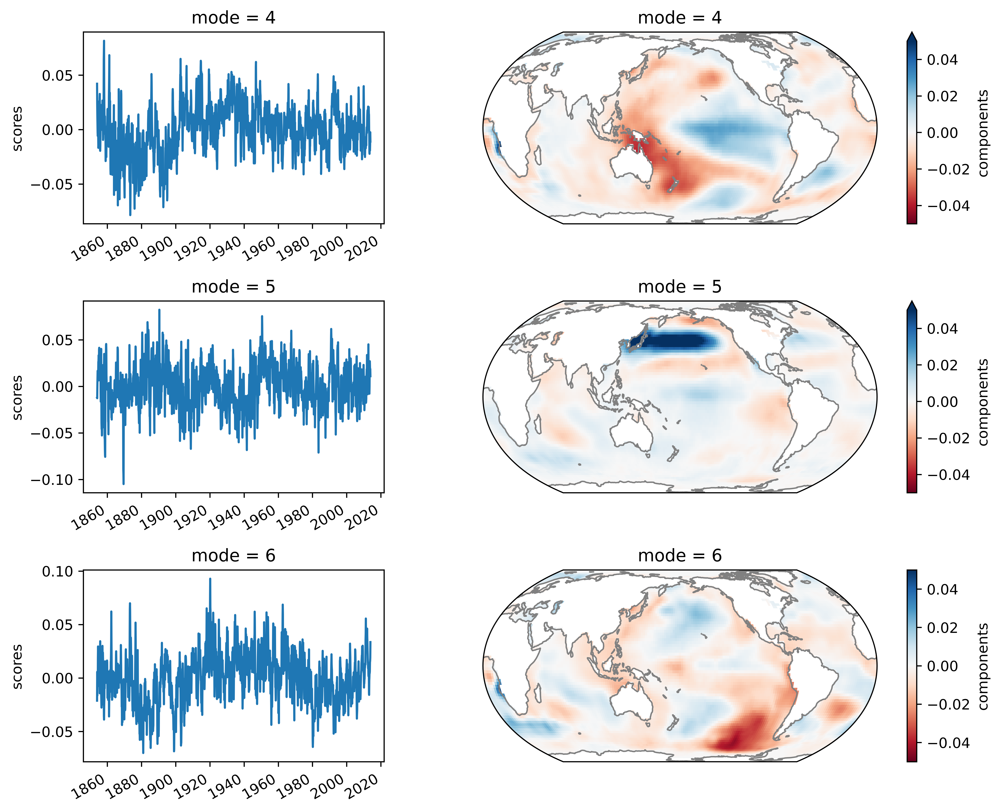

In [8]:
initial_mode=4

proj = EqualEarth(central_longitude=180)
kwargs = {"cmap": "RdBu", "vmin": -0.05, "vmax": 0.05, "transform": PlateCarree()}

fig = plt.figure(figsize=(10, 8), dpi=700)
gs = GridSpec(3, 2, width_ratios=[1, 2])
ax0 = [fig.add_subplot(gs[i, 0]) for i in range(3)]
ax1 = [fig.add_subplot(gs[i, 1], projection=proj) for i in range(3)]

for i, (a0, a1) in enumerate(zip(ax0, ax1)):
    rscores.sel(mode=i + initial_mode).plot(ax=a0)
    a1.coastlines(color=".5")
    rcomponents.sel(mode=i + initial_mode).plot(ax=a1, **kwargs)

    a0.set_xlabel("")

plt.tight_layout()

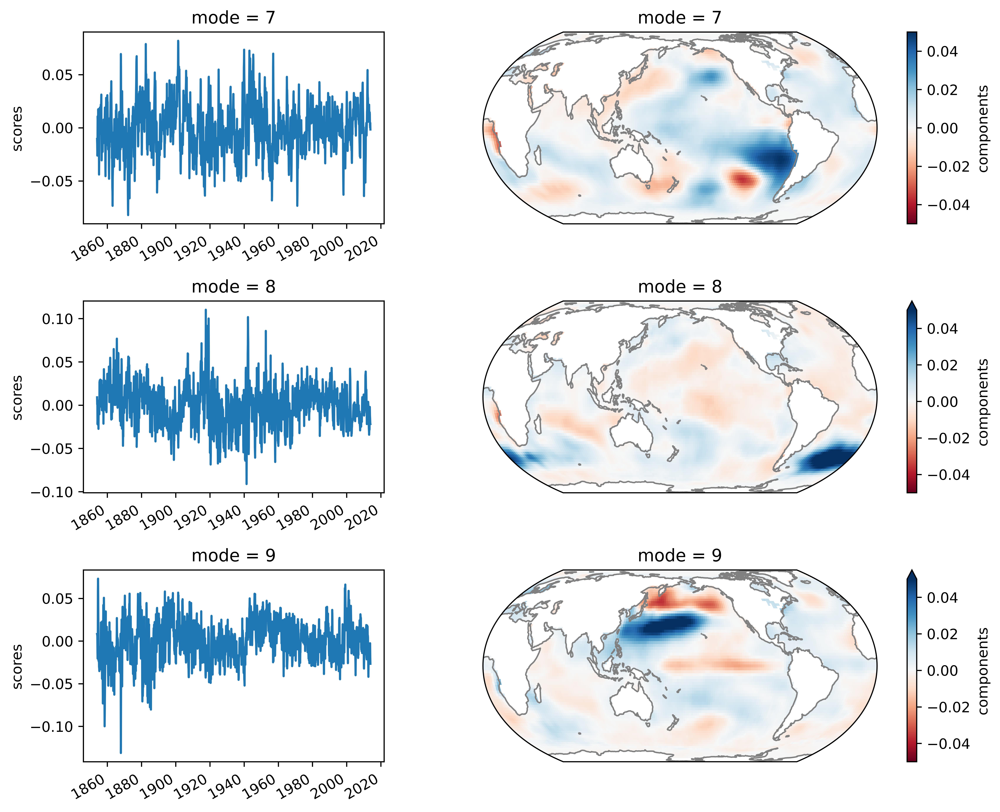

In [9]:
initial_mode=7

proj = EqualEarth(central_longitude=180)
kwargs = {"cmap": "RdBu", "vmin": -0.05, "vmax": 0.05, "transform": PlateCarree()}

fig = plt.figure(figsize=(10, 8), dpi=700)
gs = GridSpec(3, 2, width_ratios=[1, 2])
ax0 = [fig.add_subplot(gs[i, 0]) for i in range(3)]
ax1 = [fig.add_subplot(gs[i, 1], projection=proj) for i in range(3)]

for i, (a0, a1) in enumerate(zip(ax0, ax1)):
    rscores.sel(mode=i + initial_mode).plot(ax=a0)
    a1.coastlines(color=".5")
    rcomponents.sel(mode=i + initial_mode).plot(ax=a1, **kwargs)

    a0.set_xlabel("")

plt.tight_layout()

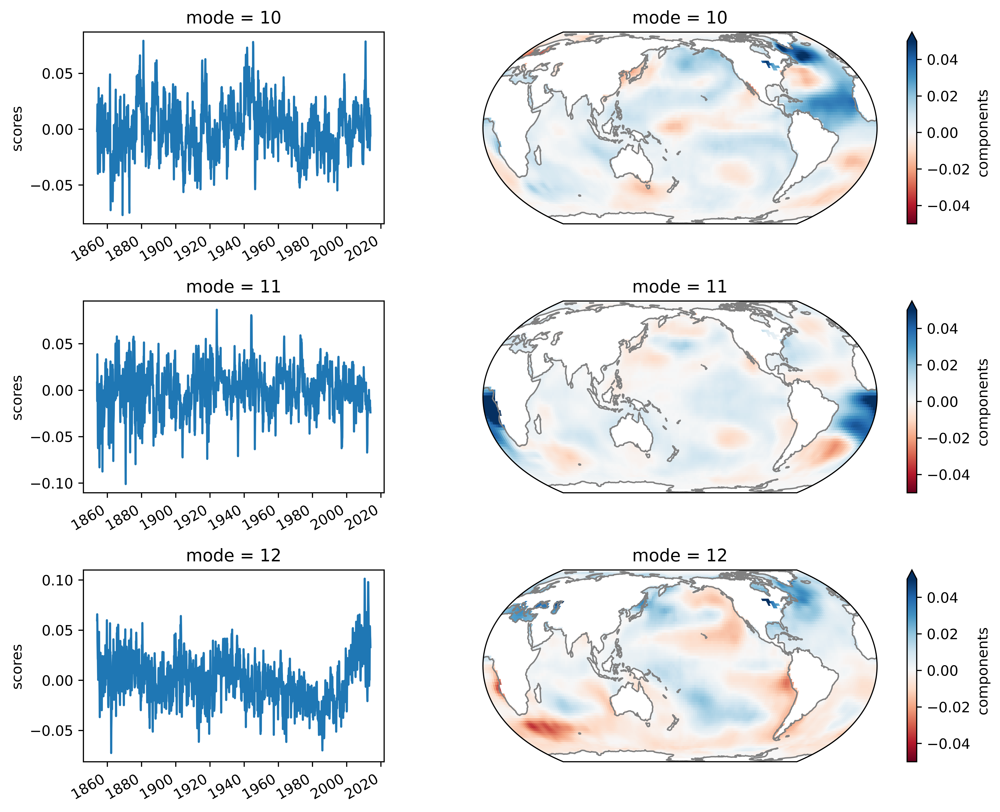

In [10]:
initial_mode=10

proj = EqualEarth(central_longitude=180)
kwargs = {"cmap": "RdBu", "vmin": -0.05, "vmax": 0.05, "transform": PlateCarree()}

fig = plt.figure(figsize=(10, 8), dpi=700)
gs = GridSpec(3, 2, width_ratios=[1, 2])
ax0 = [fig.add_subplot(gs[i, 0]) for i in range(3)]
ax1 = [fig.add_subplot(gs[i, 1], projection=proj) for i in range(3)]

for i, (a0, a1) in enumerate(zip(ax0, ax1)):
    rscores.sel(mode=i + initial_mode).plot(ax=a0)
    a1.coastlines(color=".5")
    rcomponents.sel(mode=i + initial_mode).plot(ax=a1, **kwargs)

    a0.set_xlabel("")

plt.tight_layout()

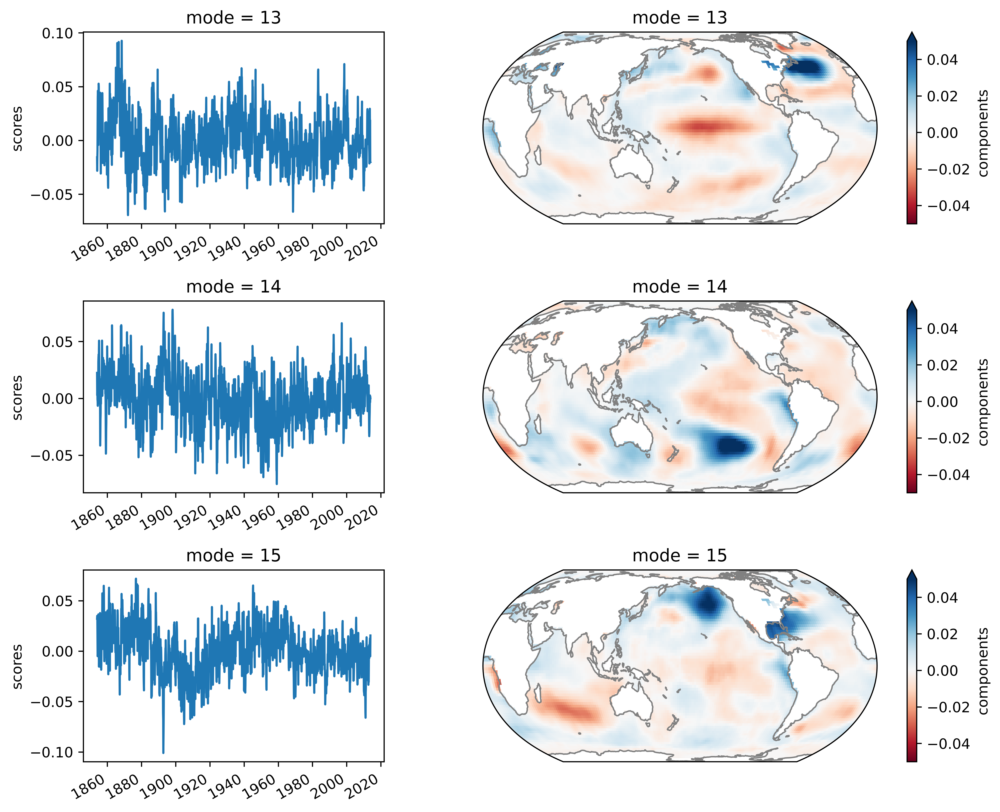

In [11]:
initial_mode=13

proj = EqualEarth(central_longitude=180)
kwargs = {"cmap": "RdBu", "vmin": -0.05, "vmax": 0.05, "transform": PlateCarree()}

fig = plt.figure(figsize=(10, 8), dpi=700)
gs = GridSpec(3, 2, width_ratios=[1, 2])
ax0 = [fig.add_subplot(gs[i, 0]) for i in range(3)]
ax1 = [fig.add_subplot(gs[i, 1], projection=proj) for i in range(3)]

for i, (a0, a1) in enumerate(zip(ax0, ax1)):
    rscores.sel(mode=i + initial_mode).plot(ax=a0)
    a1.coastlines(color=".5")
    rcomponents.sel(mode=i + initial_mode).plot(ax=a1, **kwargs)

    a0.set_xlabel("")

plt.tight_layout()

In [12]:
rcomponents.sel(mode=1).to_dataframe().reset_index()

,lat,lon,mode,components
0,-88.0,0.0,1,NaN
1,-88.0,2.0,1,NaN
2,-88.0,4.0,1,NaN
3,-88.0,6.0,1,NaN
4,-88.0,8.0,1,NaN
...,...,...,...,...
16015,88.0,350.0,1,-9.490047e-09
16016,88.0,352.0,1,-1.216669e-08
16017,88.0,354.0,1,-1.597749e-08
16018,88.0,356.0,1,-2.012135e-08


In [13]:
rscores.sel(mode=1).to_dataframe().reset_index()

,time,mode,scores
0,1854-01-01,1,-0.013369
1,1854-02-01,1,-0.012704
2,1854-03-01,1,-0.016874
3,1854-04-01,1,-0.016724
4,1854-05-01,1,-0.012701
...,...,...,...
2033,2023-06-01,1,NaN
2034,2023-07-01,1,NaN
2035,2023-08-01,1,NaN
2036,2023-09-01,1,NaN


<br>
<br>
<br>

## Plot the graphics with Basemap and SNS

In [33]:
plt.style.use('seaborn')

mode_i = 8

C:\Users\mathe\AppData\Local\Temp\ipykernel_22344\4051178096.py:1: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn')


In [34]:
time_component = rscores.sel(mode=mode_i).to_dataframe().reset_index()

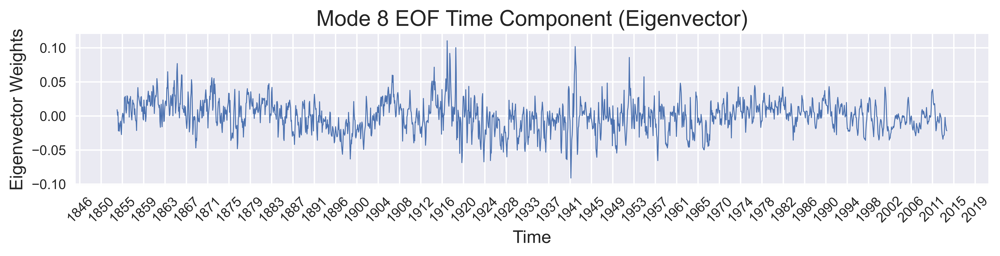

In [35]:
plt.figure(figsize=(12, 2), dpi=800)
sns.lineplot(data=time_component, x='time', y='scores', markersize=4, linewidth=0.7)
plt.title('Mode {i} EOF Time Component (Eigenvector)'.format(i=mode_i), fontsize=16)
plt.xlabel('Time', fontsize=13)
plt.ylabel('Eigenvector Weights', fontsize=13)
plt.grid(True)
plt.xticks(fontsize=10, rotation=45)  # Customize x-axis labels
plt.gca().yaxis.set_major_locator(plt.MultipleLocator(0.05))
plt.gca().xaxis.set_major_locator(plt.MultipleLocator(1500))
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
plt.show()

In [36]:
df = rcomponents.sel(mode=mode_i).to_dataframe().reset_index()

In [37]:
df.loc[:,'lon'] = df.apply(lambda x: ((x.lon+180) % 360) - 180, axis=1)

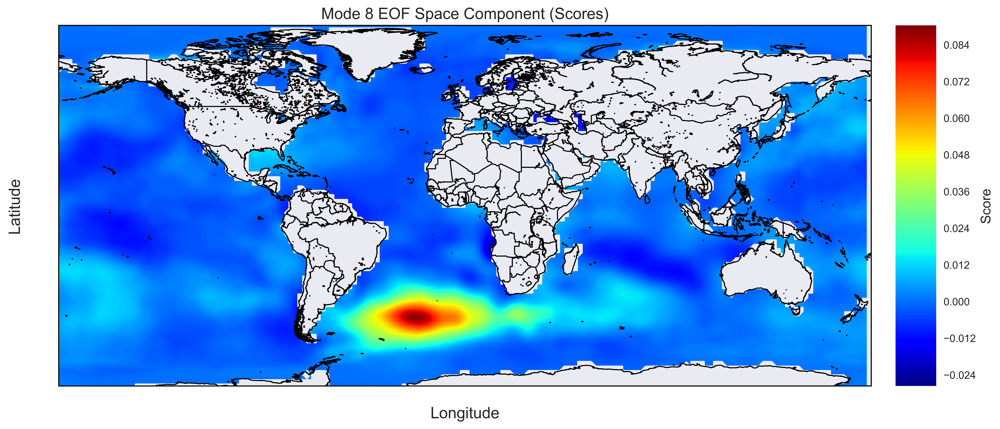

In [38]:
geometry = [Point(xy) for xy in zip(df['lon'], df['lat'])]
gdf = gpd.GeoDataFrame(df, geometry=geometry)

fig, ax = plt.subplots(figsize=(15, 15), dpi=800)

# Extract longitude, latitude, and scores
longitudes = gdf['lon'].values
latitudes = gdf['lat'].values
scores = gdf['components'].values

# Set up the Basemap
m = Basemap(projection='cyl', llcrnrlon=-180, llcrnrlat=-75, urcrnrlon=180, urcrnrlat=85, resolution='i', ax=ax)

# Generate a grid
lon_grid = np.linspace(longitudes.min(), longitudes.max(), 1000)
lat_grid = np.linspace(latitudes.min(), latitudes.max(), 1000)
lon_mesh, lat_mesh = np.meshgrid(lon_grid, lat_grid)

# Interpolate the scores onto the grid
from scipy.interpolate import griddata
score_grid = griddata((longitudes, latitudes), scores, (lon_mesh, lat_mesh), method='linear')

# Convert the grid to map coordinates
x, y = m(lon_mesh, lat_mesh)

# Draw map boundaries and features
m.drawcoastlines()
m.drawmapboundary()
m.drawcountries(linewidth=1, linestyle='solid', color='k')

# Plot the filled contour map
cs = m.contourf(x, y, score_grid, cmap='jet', levels=300)

plt.ylabel("Latitude", fontsize=15, labelpad=35)
plt.xlabel("Longitude", fontsize=15, labelpad=20)
cbar = m.colorbar(cs, location='right', pad="3%")
cbar.set_label('Score', fontsize=13)
plt.title('Mode {i} EOF Space Component (Scores)'.format(i=mode_i), fontsize=15)

# Display the plot
plt.show()